# Stopping Customers from Leaving
John is a little worrried that his team isn't doing his best to retain customers. Rather than just randomly deploying loyalty programs and techniques, he approaches you to see if there's a better way to predict which customers aren't happy. 

__About the data__:

- __id:__ unique identifier
- __state_code:__ The state the person is in.
- __tenure__: How long they have been with our current customer (months)
- __contract_length:__ lenght of contract in months
- __promotions_offered:__ if they had a promotion offer
- __remaining_term:__ how long until the contract ends (months)
- __last_nps_rating:__ Net promoting score. Measures the loyalty of customers to a company. A higher score is desirable
- __area_code:__ the code of the area
- __international_plan:__ if they get an international plan
- __voice_mail_plan:__ if they have a voice mail plan
- __number_vmail_message:__ the number of voice_mail messages
- ... different metrics

# 1. Import Data

In [134]:
# %pip install ipywidgets

In [135]:
# %pip install ydata-profiling

In [136]:
# %pip show ydata-profiling

In [137]:
import pandas as pd

%load_ext jupyter_black

The jupyter_black extension is already loaded. To reload it, use:
  %reload_ext jupyter_black


In [138]:
df = pd.read_csv("classificationdata.csv", index_col="id")

In [139]:
df.shape

(17243, 24)

In [140]:
df

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
0,HI,156,14.0,Yes,1.0,6.0,area_code_510,no,no,0,...,108,19.138302,208.349932,130,9.190181,8.015688,7,2.248902,7,no
1,MI,216,8.0,No,14.0,9.0,area_code_408,no,no,3,...,71,15.474436,228.902063,85,10.277852,9.683971,8,2.609739,3,no
2,NH,18,20.0,No,12.0,1.0,area_code_408,no,no,1,...,55,22.547297,202.353527,127,8.898488,14.039450,8,3.845776,2,no
3,MN,174,9.0,No,12.0,6.0,area_code_415,no,no,2,...,105,16.666506,214.487530,105,9.740333,13.031063,4,3.525823,1,no
4,TX,68,19.0,No,22.0,5.0,area_code_415,no,no,1,...,88,20.408969,190.047534,113,8.813303,6.760950,4,1.828652,0,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17238,NY,142,14.0,No,1.0,1.0,area_code_415,yes,no,2,...,125,14.191124,62.263008,89,2.872740,0.493638,0,0.250048,3,yes
17239,ID,93,8.0,No,9.0,7.0,area_code_415,yes,yes,29,...,134,23.784585,224.625284,95,10.627770,12.870274,6,3.370551,1,no
17240,TX,110,24.0,No,3.0,7.0,area_code_510,no,no,2,...,123,21.482982,146.474026,59,6.367553,14.037650,5,4.001911,4,no


# 2. Split Data to Prevent Snooping Bias

In [141]:
from sklearn.model_selection import train_test_split

In [142]:
train, test = train_test_split(df, test_size=0.3, random_state=1234)

In [143]:
# If our dataset is clean, we can directly go to next step
# X_temp = train.drop("churn", axis=1)
# y_temp = train["churn"]
# X_train, X_test, y_train, y_test = train_test_split(
#    X_temp, y_temp, test_size=0.3, random_state=1234, stratify=y_temp
# )

In [144]:
train.churn.value_counts()

churn
no     10314
yes     1727
Name: count, dtype: int64

# 3. Exploratory Data Analysis

## Birds Eye View

In [145]:
from matplotlib import pyplot as plt

In [146]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Index: 12070 entries, 16692 to 1318
Data columns (total 24 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   state_code                     12070 non-null  object 
 1   tenure                         12070 non-null  int64  
 2   contract_length                12041 non-null  float64
 3   promotions_offered             12041 non-null  object 
 4   remaining_term                 12041 non-null  float64
 5   last_nps_rating                12041 non-null  float64
 6   area_code                      12063 non-null  object 
 7   international_plan             12070 non-null  object 
 8   voice_mail_plan                12050 non-null  object 
 9   number_vmail_messages          12070 non-null  int64  
 10  total_day_minutes              12070 non-null  float64
 11  total_day_calls                12070 non-null  int64  
 12  total_day_charge               12070 non-null  f

In [147]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered               29
remaining_term                   29
last_nps_rating                  29
area_code                         7
international_plan                0
voice_mail_plan                  20
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                12
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
dtype: int64

In [148]:
train.describe()

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
count,12070.000000,12041.000000,12041.000000,12041.000000,12070.000000,12070.000000,12070.000000,12070.000000,12058.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000,12070.000000
mean,100.310771,15.924840,11.137115,6.102815,8.638608,179.821368,100.064374,30.574659,200.288303,100.416984,17.014347,199.546252,99.791881,8.979010,10.300118,4.961806,2.774743,1.555344
std,39.742023,4.904918,7.212212,2.723722,13.030305,54.694309,20.137844,9.301168,50.899001,19.898596,4.319807,50.871813,20.195931,2.285268,2.804826,2.508605,0.750105,1.317849
min,1.000000,8.000000,1.000000,1.000000,0.000000,1.383902,1.000000,0.119603,7.605489,1.000000,1.052621,4.247707,1.000000,0.472320,0.032252,0.000000,0.013478,0.000000
25%,73.000000,12.000000,5.000000,4.000000,1.000000,142.621175,87.000000,24.323777,166.719227,87.000000,14.152096,165.683627,86.000000,7.446210,8.529475,3.000000,2.299756,1.000000
50%,100.000000,16.000000,10.000000,7.000000,2.000000,179.705079,100.000000,30.517433,200.746807,101.000000,17.049083,198.635687,99.000000,8.952996,10.382980,5.000000,2.812103,1.000000
75%,127.000000,20.000000,17.000000,8.000000,16.000000,217.024361,113.000000,36.834662,233.943152,114.000000,19.870764,234.236992,114.000000,10.520554,12.066125,6.000000,3.256842,2.000000
max,238.000000,24.000000,24.000000,10.000000,52.000000,351.091823,165.000000,59.727092,357.739429,169.000000,30.474658,394.851052,173.000000,17.700351,19.981388,20.000000,5.398333,9.000000


In [149]:
train.describe(include="object")

,state_code,promotions_offered,area_code,international_plan,voice_mail_plan,churn
count,12070,12041,12063,12070,12050,12041
unique,51,3,3,2,2,2
top,WV,No,area_code_415,no,no,no
freq,398,10957,6049,10957,8887,10314


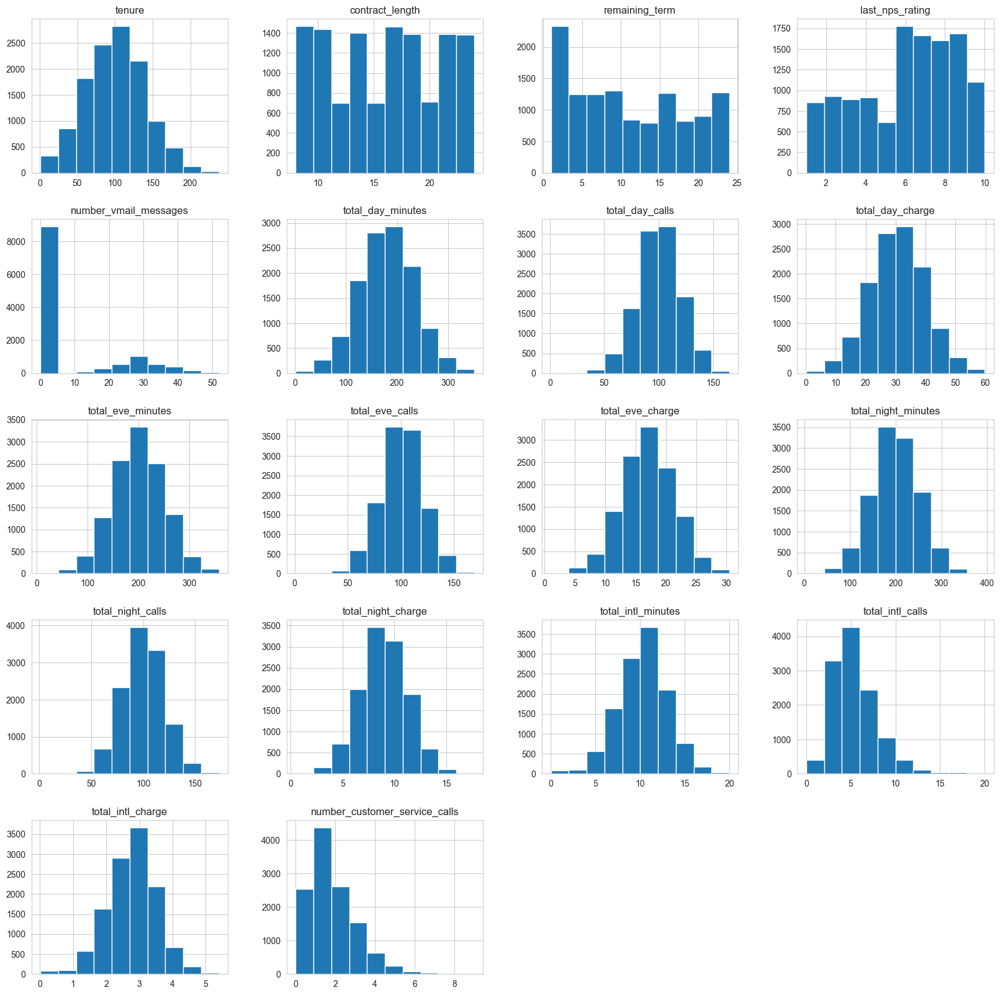

In [150]:
%matplotlib inline
train.hist(figsize=(20, 20))
plt.show()

## Faster EDA with Pandas Profiling

In [151]:
# Import pandas profiling
from ydata_profiling import ProfileReport

In [152]:
# Create new profile report
profile = ProfileReport(train, title="Pandas Profiling Report")

In [153]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Analyse Categorical Features

### Inspect Target Features

In [154]:
# Import data viz capabilities
from matplotlib import pyplot as plt
import seaborn as sns

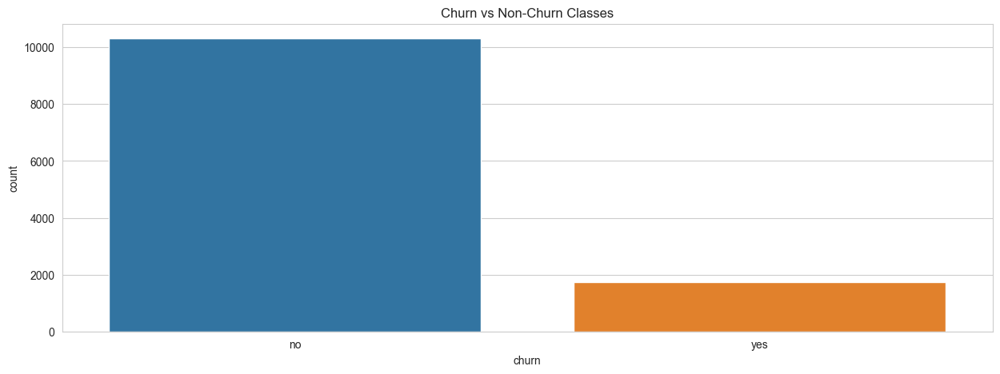

In [155]:
plt.figure(figsize=(15, 5))
sns.countplot(x="churn", data=train).set_title("Churn vs Non-Churn Classes")
plt.show()

we are going to handle imbalanced data later on.

### Inspect State, Area Code and Promotions Offered

In [156]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

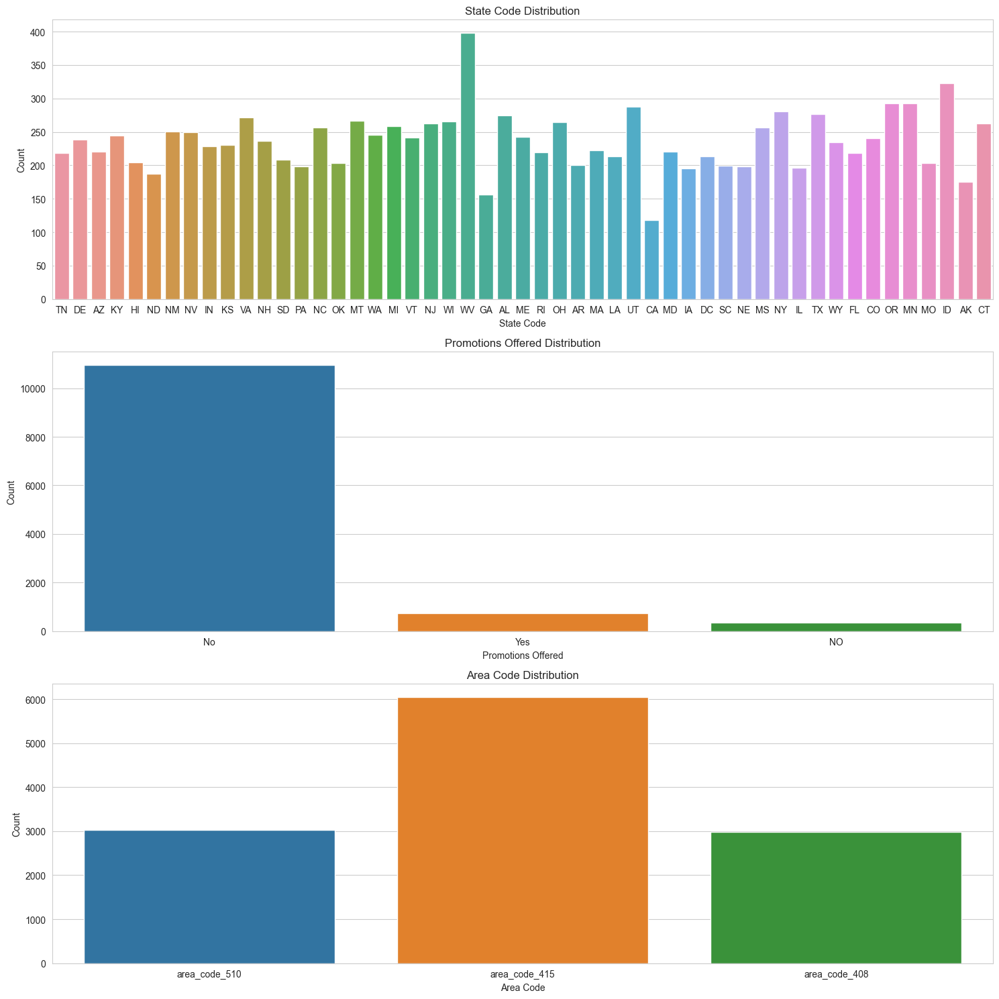

In [157]:
# Data for plotting
plot_data = [
    ("state_code", "State Code Distribution", "State Code"),
    ("promotions_offered", "Promotions Offered Distribution", "Promotions Offered"),
    ("area_code", "Area Code Distribution", "Area Code"),
]

# Setting a common style
sns.set_style("whitegrid")

# Creating subplots
fig, axs = plt.subplots(len(plot_data), 1, figsize=(15, 15))

# Looping through the data to create each subplot
for i, (column, title, xlabel) in enumerate(plot_data):
    sns.countplot(data=train, x=column, ax=axs[i])
    axs[i].set_title(title)
    axs[i].set_xlabel(xlabel)
    axs[i].set_ylabel("Count")

# Adjust layout for better spacing
plt.tight_layout()

# Display the plots
plt.show()

In [158]:
# Save plot to disc
fig.get_figure().savefig("outputplot.png")

## Analyse Numeric Features

### Inspect Vmail messages and Customer Service Calls

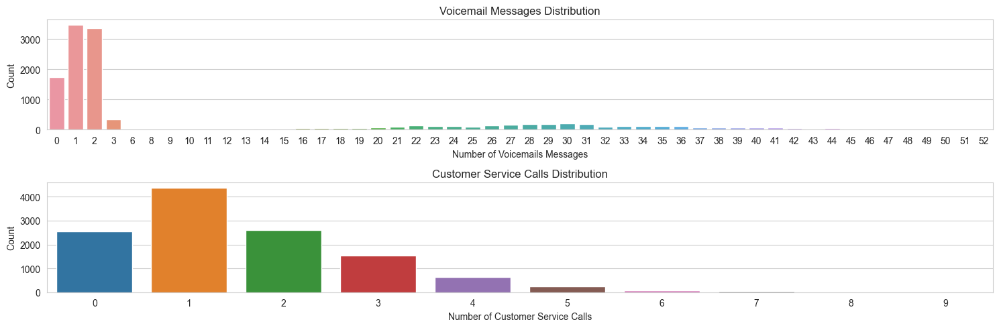

In [159]:
# Viz on vmail messages and customer service calls
plot_data = [
    (
        "number_vmail_messages",
        "Voicemail Messages Distribution",
        "Number of Voicemails Messages",
    ),
    (
        "number_customer_service_calls",
        "Customer Service Calls Distribution",
        "Number of Customer Service Calls",
    ),
]

# Creating subplots
fig, axs = plt.subplots(len(plot_data), 1, figsize=(15, 5))

# Looping through the data to create each subplot
for i, (column, title, xlabel) in enumerate(plot_data):
    sns.countplot(data=train, x=column, ax=axs[i])
    axs[i].set_title(title)
    axs[i].set_xlabel(xlabel)
    axs[i].set_ylabel("Count")

# Adjust layout for better spacing
plt.tight_layout()

# Display the plots
plt.show()

In [160]:
fig.get_figure().savefig("newplot.png")

### Analyse Customer Service Calls given it's Skewed

In [161]:
import numpy as np

In [162]:
train["number_customer_service_calls"].skew()

1.086776733503893

In [163]:
train["log_customer_service_calls"] = np.log(train["number_customer_service_calls"] + 1)

In [164]:
train["log_customer_service_calls"].skew()

-0.11828354478767099

applying the log transformation is a lot better. Let's visualize it.

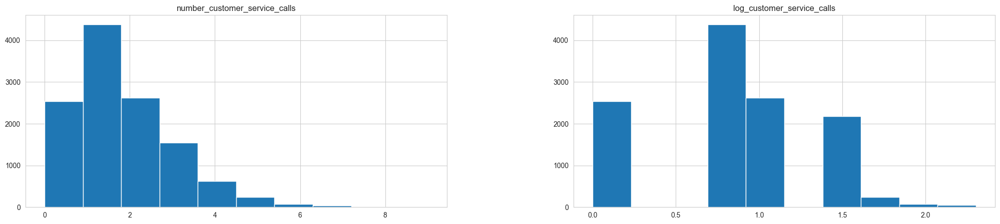

In [165]:
train[["number_customer_service_calls", "log_customer_service_calls"]].hist(
    figsize=(25, 5)
)
plt.show()

Although we have some gaps, it's still better to do this, especially if our machine learning model is expecting normaly distributed features.
In the EDA, we don't want to create new features so we drop the new column for now and will come back later on.

In [166]:
train = train.drop("log_customer_service_calls", axis=1)

## Analyse Relationships

### Look into Numeric/Numeric Correlation

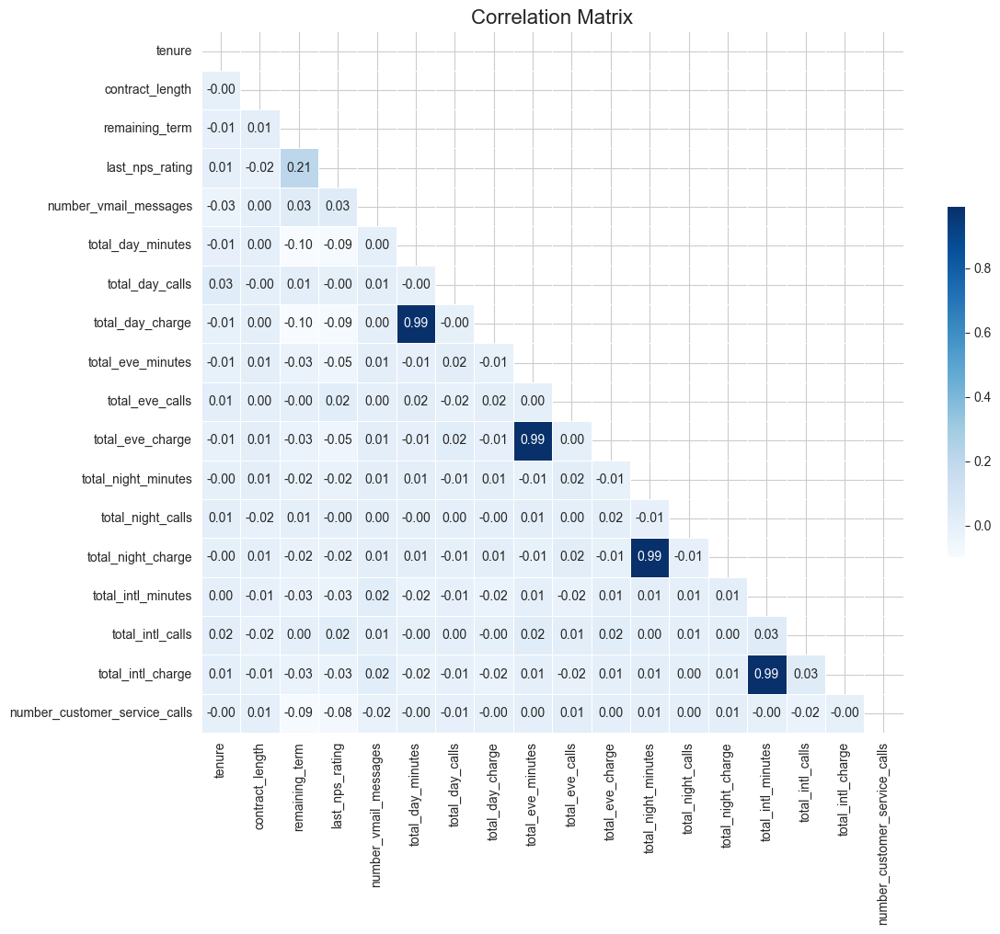

In [167]:
# Calculate the correlation matrix
corr = train.select_dtypes(exclude="object").corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
plt.figure(figsize=(12, 10))

# Add a title
plt.title("Correlation Matrix", fontsize=16)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(
    corr,
    mask=mask,
    annot=True,
    fmt=".2f",
    cmap="Blues",
    square=True,
    linewidths=0.5,
    cbar_kws={"shrink": 0.5},
)
plt.tight_layout()

# Show the plot
plt.show()

In [168]:
train.dtypes

state_code                        object
tenure                             int64
contract_length                  float64
promotions_offered                object
remaining_term                   float64
last_nps_rating                  float64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

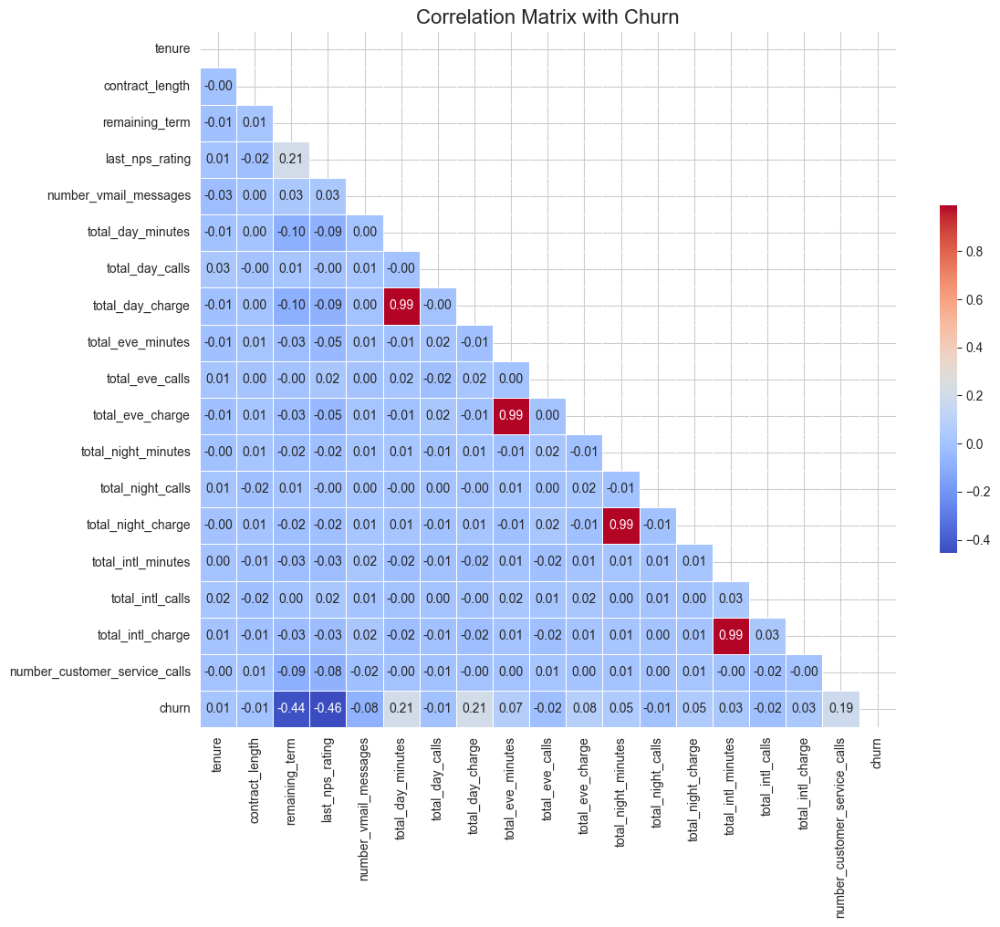

In [169]:
temp = train.copy()
temp["churn"] = temp["churn"].apply(lambda x: 1 if x == "yes" else 0)

corr = temp.select_dtypes(exclude="object").corr()

mask = np.triu(np.ones_like(corr, dtype=bool))

plt.figure(figsize=(12, 10))

plt.title("Correlation Matrix with Churn", fontsize=16)

sns.heatmap(
    corr,
    mask=mask,
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    square=True,
    linewidths=0.5,
    cbar_kws={"shrink": 0.5},
)
plt.tight_layout()
plt.show()

### Plot Churn Distributions

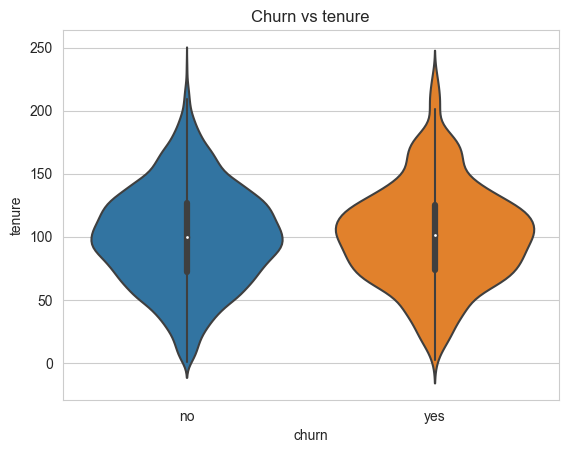

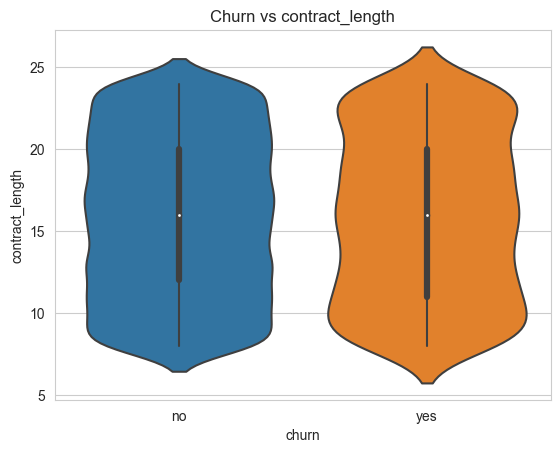

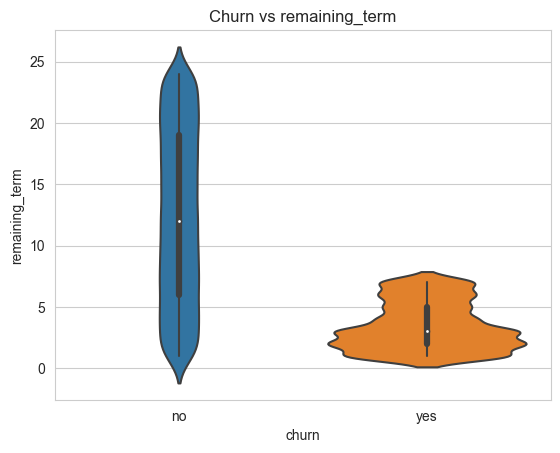

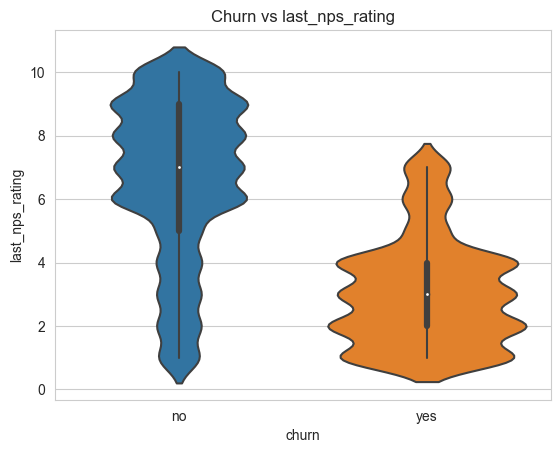

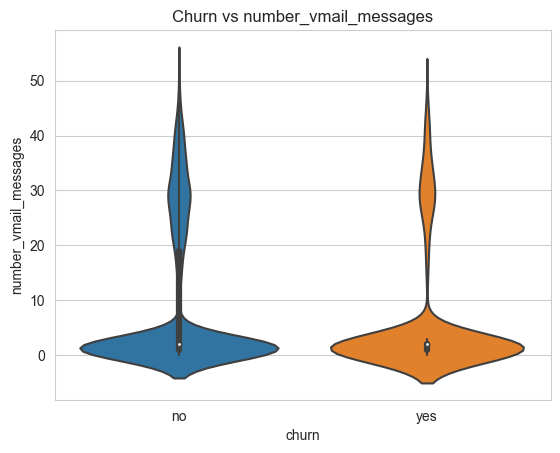

...

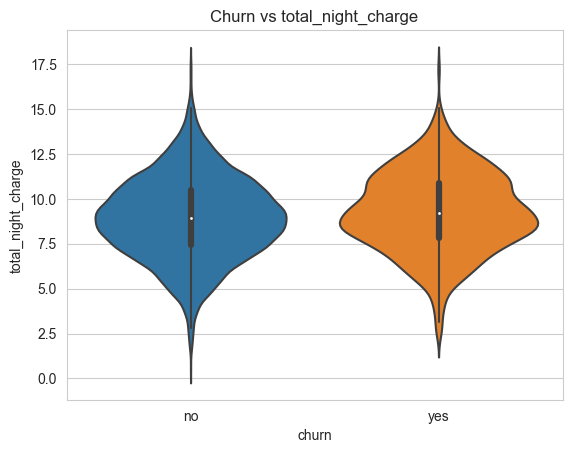

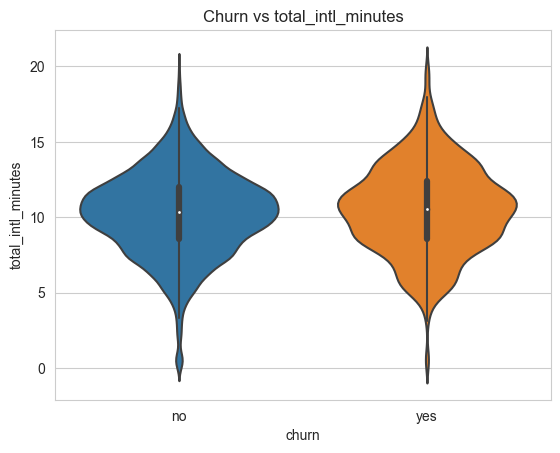

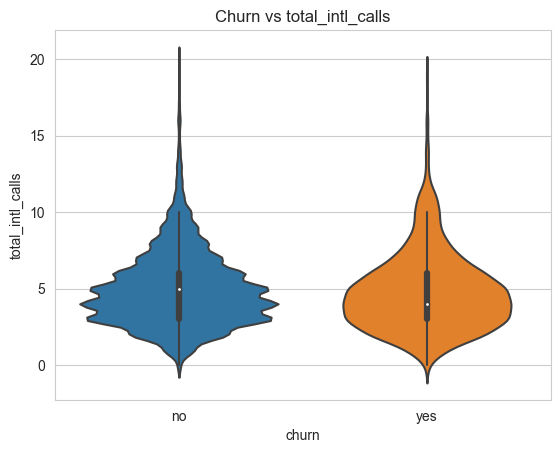

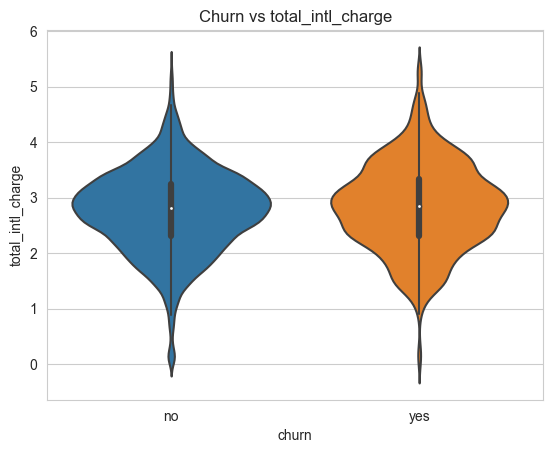

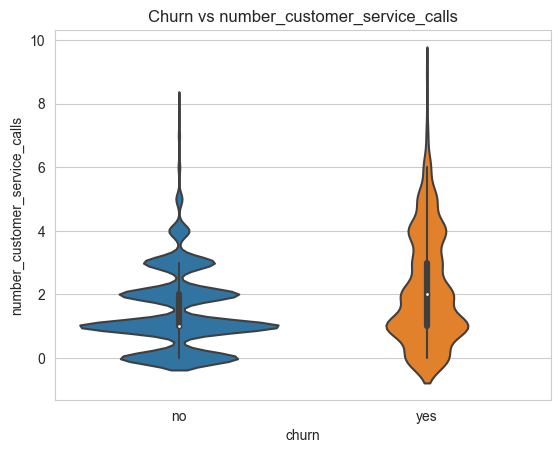

In [170]:
# Plot out the distributions against churn
for col in train.select_dtypes(exclude="object").columns:
    sns.violinplot(x="churn", y=col, data=train).set_title(f"Churn vs {col}")
    plt.show()

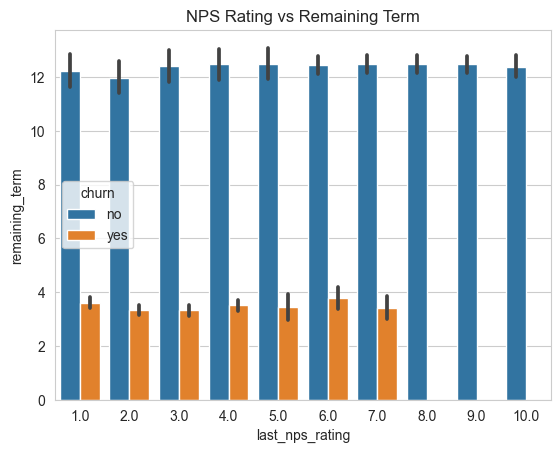

In [171]:
plt.title("NPS Rating vs Remaining Term")
sns.barplot(x="last_nps_rating", y="remaining_term", hue="churn", data=train)
plt.show()

### What about Categorical Relationships to Churn

In [172]:
# Display unique features
train.promotions_offered.unique()

array(['No', 'Yes', 'NO', nan], dtype=object)

In [173]:
# Filling in incorrectly Labeled features
train["promotions_offered"] = train["promotions_offered"].replace(["NO", np.NaN], "No")

In [174]:
train.promotions_offered.unique()

array(['No', 'Yes'], dtype=object)

In [175]:
# Pivot
pivot_feature = "promotions_offered"
pd.crosstab(train[pivot_feature], train["churn"]) / len(train)

churn,no,yes
promotions_offered,,
No,0.822038,0.115659
Yes,0.032477,0.027423


In [176]:
# Loop through and create a crosstab for all categorical features
for col in train.select_dtypes(include="object").columns:
    if col != "churn":
        display(pd.crosstab(train[col], train["churn"]) / len(train))

churn,no,yes
state_code,,
AK,0.013670,0.000829
AL,0.019553,0.002900
AR,0.014167,0.002403
AZ,0.016321,0.001657
CA,0.007539,0.002237
CO,0.017647,0.002237
CT,0.018558,0.003231
DC,0.014250,0.003065
DE,0.016239,0.003480


churn,no,yes
promotions_offered,,
No,0.822038,0.115659
Yes,0.032477,0.027423


churn,no,yes
area_code,,
area_code_408,0.210025,0.036205
area_code_415,0.430655,0.069097
area_code_510,0.213256,0.037780


churn,no,yes
international_plan,,
no,0.796935,0.108451
yes,0.057581,0.034631


churn,no,yes
voice_mail_plan,,
no,0.616321,0.118973
yes,0.237117,0.023529


### Is there a relationship between Remaining term and NPS Rating? And...promotions offered?
Namely when Remaining term < 5 and Last nps rating < 7

In [177]:
# Creating new columns in order to get easier crosstabs
train["nps_less_7"] = (train["last_nps_rating"] <= 7).astype(int)
train["remaining_term_less_5"] = (train["remaining_term"] < 5).astype(int)
train["churn_yes"] = train["churn"].apply(lambda x: 1 if x == "yes" else 0)
train["churn_no"] = train["churn"].apply(lambda x: 0 if x == "yes" else 1)

In [178]:
train.groupby(["nps_less_7", "remaining_term_less_5"]).sum(["churn_yes", "churn_no"])[
    ["churn_yes", "churn_no"]
] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5                     
0          0                       0.000000  0.305220
           1                       0.000000  0.061392
1          0                       0.043331  0.405468
           1                       0.099751  0.084838

- People that have nps rating more than 7 do not churn.

In [179]:
train.groupby(["nps_less_7", "remaining_term_less_5", "promotions_offered"]).sum(
    ["churn_yes", "churn_no"]
)[["churn_yes", "churn_no"]] / len(train)

churn_yes  churn_no
nps_less_7 remaining_term_less_5 promotions_offered                     
0          0                     No                   0.000000  0.305220
           1                     No                   0.000000  0.061392
1          0                     No                   0.035543  0.405468
                                 Yes                  0.007788  0.000000
           1                     No                   0.080116  0.052361
                                 Yes                  0.019635  0.032477

interesting ! people that rate nps more than 7, have remaining terms more than 5 but weren't offered promotions, and have churn represent 8% total which is a lot comparing of the 14% that churn overall.

In [180]:
train.churn.value_counts(normalize=True)

churn
no     0.856573
yes    0.143427
Name: proportion, dtype: float64

Let's drop those columns because we are still in the EDA process

In [181]:
train.drop(
    ["nps_less_7", "remaining_term_less_5", "churn_yes", "churn_no"],
    axis=1,
    inplace=True,
)

# 4. Data Preprocessing

## Double check we're operating with a clean slate

Which means, that we have the same columns as we have in our original df.

In [182]:
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

In [183]:
df.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls', 'churn'],
      dtype='object')

In [184]:
[col in df.columns for col in train.columns]

[True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True,
 True]

## Missing Area Code Data - Categorical

In [185]:
train[train["area_code"].isnull()].head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
17168,WY,54,18.0,No,19.0,7.0,NaN,no,NaN,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
4558,WY,58,22.0,No,20.0,6.0,NaN,no,NaN,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
13336,RI,79,13.0,No,9.0,6.0,NaN,no,no,2,...,68,14.943610,162.052384,106,7.171747,13.576263,6,3.658442,1,no
5772,MO,155,12.0,No,3.0,9.0,NaN,yes,no,0,...,98,8.018185,200.103367,96,9.318969,7.688405,7,1.940647,0,no
1642,MO,154,15.0,No,2.0,7.0,NaN,yes,no,1,...,100,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no


In [186]:
# Fill na with the word 'missing'
train["area_code"] = train["area_code"].fillna("missing")
train[train["area_code"] == "missing"]

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
17168,WY,54,18.0,No,19.0,7.0,missing,no,NaN,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
4558,WY,58,22.0,No,20.0,6.0,missing,no,NaN,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
13336,RI,79,13.0,No,9.0,6.0,missing,no,no,2,...,68,14.943610,162.052384,106,7.171747,13.576263,6,3.658442,1,no
5772,MO,155,12.0,No,3.0,9.0,missing,yes,no,0,...,98,8.018185,200.103367,96,9.318969,7.688405,7,1.940647,0,no
1642,MO,154,15.0,No,2.0,7.0,missing,yes,no,1,...,100,8.753738,198.839157,94,9.278937,7.073209,6,1.943637,0,no
16450,FL,147,16.0,No,9.0,8.0,missing,yes,no,1,...,93,20.838636,187.249514,66,8.307897,8.289207,5,2.255682,2,no
12972,MO,153,24.0,No,13.0,6.0,missing,yes,no,0,...,98,8.515226,207.015705,92,9.090795,7.466579,6,2.008288,0,no


## Missing Voice Mail Plan - Categorical

In [187]:
# Fill na with the word 'missing'
train["voice_mail_plan"] = train["voice_mail_plan"].fillna("missing")
train[train["voice_mail_plan"] == "missing"]

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
16429,HI,44,21.0,No,20.0,10.0,area_code_510,no,missing,1,...,102,18.016167,187.208784,90,8.690546,11.481874,2,3.017702,1,no
10372,HI,42,8.0,No,7.0,6.0,area_code_510,no,missing,2,...,106,17.749234,185.584080,92,8.224325,11.041335,2,3.105547,1,no
11974,MO,15,14.0,No,17.0,9.0,area_code_510,no,missing,1,...,69,11.871465,145.341081,102,7.051341,8.259750,9,2.296696,1,no
3365,MO,18,22.0,No,12.0,2.0,area_code_415,no,missing,2,...,77,22.896967,178.095650,103,8.785522,6.028258,6,1.874301,0,no
17168,WY,54,18.0,No,19.0,7.0,missing,no,missing,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
7767,AZ,4,9.0,No,7.0,3.0,area_code_408,no,missing,0,...,119,21.481234,281.874501,91,12.695069,11.408316,4,3.225750,1,yes
16037,AZ,6,16.0,No,3.0,2.0,area_code_408,no,missing,2,...,122,22.108010,288.967333,88,13.270796,11.430051,3,3.059472,1,yes
4558,WY,58,22.0,No,20.0,6.0,missing,no,missing,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
8645,MT,60,17.0,Yes,1.0,4.0,area_code_415,no,missing,1,...,75,19.991544,180.150988,108,8.345667,9.549767,3,2.468519,1,yes


## Missing Evening Minutes - Numeric

In [188]:
train[train["total_eve_minutes"].isnull()]

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
id,,,,,,,,,,,,,,,,,,,,,
16142,AZ,133,14.0,No,12.0,8.0,area_code_415,no,no,2,...,98,6.767451,189.817883,77,8.295507,9.916673,20,2.599281,0,no
17168,WY,54,18.0,No,19.0,7.0,missing,no,missing,40,...,111,16.548064,193.086752,114,8.808353,9.344790,4,2.634894,0,no
4558,WY,58,22.0,No,20.0,6.0,missing,no,missing,41,...,111,15.370818,185.992442,115,8.634951,9.258257,4,2.522559,0,no
11193,CO,79,21.0,No,6.0,4.0,area_code_408,no,no,1,...,120,13.966225,212.912464,67,9.408010,5.764707,7,1.573547,5,yes
15828,SC,113,8.0,No,6.0,8.0,area_code_415,no,no,1,...,108,10.760952,192.849730,107,8.807009,7.065008,6,2.009913,2,no
12703,CO,79,23.0,No,5.0,1.0,area_code_408,no,no,1,...,125,14.441229,209.347350,67,9.067451,5.459496,7,1.384230,5,yes
2729,SC,119,11.0,No,7.0,5.0,area_code_415,no,no,0,...,103,11.612971,182.751530,105,8.101761,7.526092,7,2.072387,2,no
11475,AZ,124,9.0,No,8.0,7.0,area_code_415,no,no,1,...,97,6.219338,185.960562,73,8.576426,9.575505,19,2.514556,0,no
15905,SC,117,10.0,No,23.0,8.0,area_code_415,no,no,2,...,104,12.047270,178.829159,111,8.583951,7.343811,6,1.934149,2,no


In [312]:
mean_eve_mins = train["total_eve_minutes"].mean().round(2)
mean_eve_mins

KeyError: 'total_eve_minutes'

In [190]:
train["total_eve_minutes_missing"] = train["total_eve_minutes"].isnull().astype(int)
train["total_eve_minutes"] = train["total_eve_minutes"].fillna(mean_eve_mins)

In [191]:
train[train["total_eve_minutes_missing"] == 1][
    ["total_eve_minutes_missing", "total_eve_minutes"]
]

,total_eve_minutes_missing,total_eve_minutes
id,,
16142,1,200.29
17168,1,200.29
4558,1,200.29
11193,1,200.29
15828,1,200.29
12703,1,200.29
2729,1,200.29
11475,1,200.29
15905,1,200.29


## Missing Target Variables

In [192]:
train.isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered                0
remaining_term                   29
last_nps_rating                  29
area_code                         0
international_plan                0
voice_mail_plan                   0
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                 0
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
total_eve_minutes_missing         0
dtype: int64

In [193]:
train[train["churn"].isnull()].isnull().sum()

state_code                        0
tenure                            0
contract_length                  29
promotions_offered                0
remaining_term                   29
last_nps_rating                  29
area_code                         0
international_plan                0
voice_mail_plan                   0
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                 0
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                            29
total_eve_minutes_missing         0
dtype: int64

In [194]:
# drop missing values of the target variable
train = train[~train["churn"].isnull()]
train.isnull().sum()

state_code                       0
tenure                           0
contract_length                  0
promotions_offered               0
remaining_term                   0
last_nps_rating                  0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_minutes                0
total_day_calls                  0
total_day_charge                 0
total_eve_minutes                0
total_eve_calls                  0
total_eve_charge                 0
total_night_minutes              0
total_night_calls                0
total_night_charge               0
total_intl_minutes               0
total_intl_calls                 0
total_intl_charge                0
number_customer_service_calls    0
churn                            0
total_eve_minutes_missing        0
dtype: int64

# 5. Feature Engineering

## Ratio for Correlated Predictor Variables

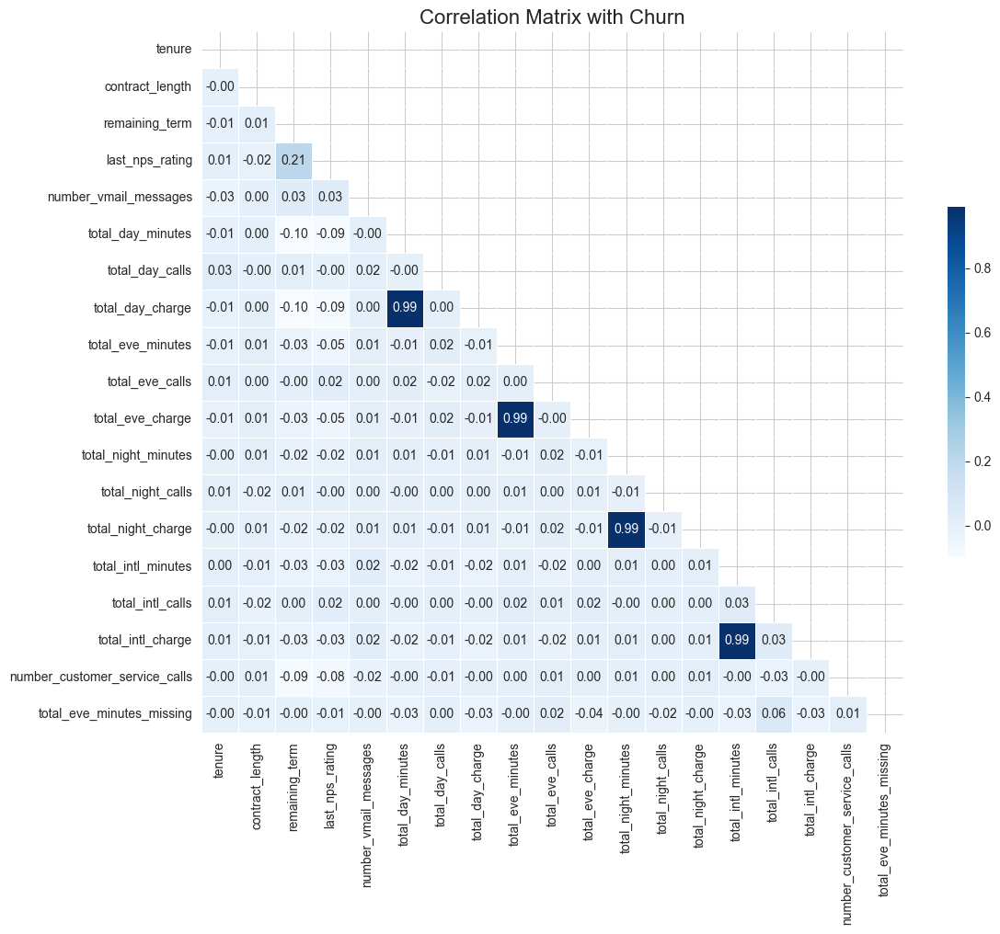

In [195]:
corr = train.select_dtypes(exclude="object").corr()

mask = np.triu(np.ones_like(corr, dtype=bool))

plt.figure(figsize=(12, 10))

plt.title("Correlation Matrix with Churn", fontsize=16)

sns.heatmap(
    corr,
    mask=mask,
    annot=True,
    fmt=".2f",
    cmap="Blues",
    square=True,
    linewidths=0.5,
    cbar_kws={"shrink": 0.5},
)
plt.tight_layout()
plt.show()

In [196]:
# Create ratios
train["day_ratio"] = train["total_day_charge"] / train["total_day_minutes"]
train["eve_ratio"] = train["total_eve_charge"] / train["total_eve_minutes"]
train["night_ratio"] = train["total_night_charge"] / train["total_night_minutes"]
train["intl_ratio"] = train["total_intl_charge"] / train["total_intl_minutes"]

In [197]:
train.head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn,total_eve_minutes_missing,day_ratio,eve_ratio,night_ratio,intl_ratio
id,,,,,,,,,,,,,,,,,,,,,
16692,TN,100,18.0,No,23.0,9.0,area_code_510,no,no,2,...,8.308312,9,2.208759,2,no,0,0.172815,0.083632,0.043008,0.265849
6970,DE,92,15.0,No,7.0,7.0,area_code_510,no,no,0,...,8.238645,2,2.168779,1,yes,0,0.169215,0.084485,0.045763,0.263245
9747,AZ,62,10.0,No,18.0,10.0,area_code_415,no,yes,20,...,11.084169,5,3.153671,0,no,0,0.158396,0.088938,0.046510,0.284520
16099,KY,143,12.0,No,12.0,6.0,area_code_408,no,no,1,...,19.981388,4,5.242569,0,no,0,0.178475,0.086951,0.043587,0.262373
8833,HI,123,19.0,No,23.0,7.0,area_code_510,no,no,0,...,11.670808,9,3.205746,2,no,0,0.168656,0.081817,0.043780,0.274681


In [198]:
train = train.drop(
    [
        "total_day_charge",
        "total_eve_charge",
        "total_night_charge",
        "total_intl_charge",
        "total_day_minutes",
        "total_eve_minutes",
        "total_night_minutes",
        "total_intl_minutes",
    ],
    axis=1,
)

In [199]:
train.columns

Index(['state_code', 'tenure', 'contract_length', 'promotions_offered',
       'remaining_term', 'last_nps_rating', 'area_code', 'international_plan',
       'voice_mail_plan', 'number_vmail_messages', 'total_day_calls',
       'total_eve_calls', 'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'churn', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio'],
      dtype='object')

## Skewed Customer Service Calls

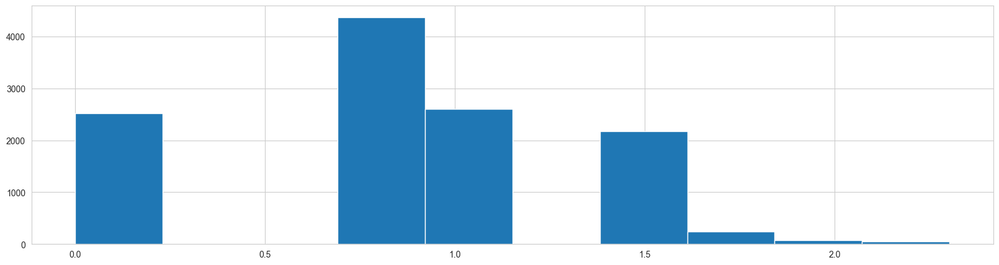

In [200]:
train["number_customer_service_calls"] = np.log(
    train["number_customer_service_calls"] + 1
)
train["number_customer_service_calls"].hist(figsize=(20, 5))
plt.show()

## Feature Engineering Unhappy Customers

In [201]:
train["promotions_offered"] = train["promotions_offered"].replace(["NO", np.NaN], "No")

In [202]:
train.isnull().sum()

state_code                       0
tenure                           0
contract_length                  0
promotions_offered               0
remaining_term                   0
last_nps_rating                  0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_calls                  0
total_eve_calls                  0
total_night_calls                0
total_intl_calls                 0
number_customer_service_calls    0
churn                            0
total_eve_minutes_missing        0
day_ratio                        0
eve_ratio                        0
night_ratio                      0
intl_ratio                       0
dtype: int64

In [203]:
train["unhappy_customers"] = (
    (train.remaining_term < 5)
    & (train.last_nps_rating <= 7)
    & (train.promotions_offered == "No")
).astype(int)

In [204]:
train[train["unhappy_customers"] == 1].head()

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_night_calls,total_intl_calls,number_customer_service_calls,churn,total_eve_minutes_missing,day_ratio,eve_ratio,night_ratio,intl_ratio,unhappy_customers
id,,,,,,,,,,,,,,,,,,,,,
3584,NM,182,10.0,No,3.0,3.0,area_code_408,no,yes,30,...,118,1,1.386294,no,0,0.169449,0.087521,0.045246,0.274974,1
17212,OK,103,23.0,No,4.0,2.0,area_code_415,no,no,2,...,89,16,0.693147,yes,0,0.169476,0.084495,0.045747,0.258265,1
2321,MT,100,22.0,No,2.0,7.0,area_code_415,no,no,1,...,81,4,0.693147,no,0,0.171099,0.083300,0.044048,0.267411,1
15834,WA,58,23.0,No,2.0,3.0,area_code_408,no,no,1,...,142,8,0.000000,yes,0,0.171940,0.089352,0.047560,0.274232,1
8608,IN,67,9.0,No,2.0,4.0,area_code_510,no,no,2,...,99,6,1.098612,yes,0,0.175524,0.084723,0.043051,0.246410,1


## Create Target and Feature Variables

In [205]:
from sklearn.preprocessing import OneHotEncoder

In [206]:
# Create X and y variables
X_train = train.drop("churn", axis=1)
y_train = np.where(train["churn"] == "yes", 1, 0)

In [207]:
# Validating churn is dropped
"churn" in list(X_train.columns)

False

In [208]:
# Check y value
y_train

array([0, 1, 0, ..., 0, 0, 0])

In [209]:
# Create the one hot encoder
onehot = OneHotEncoder(handle_unknown="ignore")
# Apply one hot encoding to categorical columns
encoded_columns = onehot.fit_transform(
    X_train.select_dtypes(include="object")
).toarray()

In [313]:
type(onehot)

sklearn.preprocessing._encoders.OneHotEncoder

In [210]:
encoded_columns

array([[0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.],
       ...,
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.]])

In [211]:
onehot.get_feature_names_out()

array(['state_code_AK', 'state_code_AL', 'state_code_AR', 'state_code_AZ',
       'state_code_CA', 'state_code_CO', 'state_code_CT', 'state_code_DC',
       'state_code_DE', 'state_code_FL', 'state_code_GA', 'state_code_HI',
       'state_code_IA', 'state_code_ID', 'state_code_IL', 'state_code_IN',
       'state_code_KS', 'state_code_KY', 'state_code_LA', 'state_code_MA',
       'state_code_MD', 'state_code_ME', 'state_code_MI', 'state_code_MN',
       'state_code_MO', 'state_code_MS', 'state_code_MT', 'state_code_NC',
       'state_code_ND', 'state_code_NE', 'state_code_NH', 'state_code_NJ',
       'state_code_NM', 'state_code_NV', 'state_code_NY', 'state_code_OH',
       'state_code_OK', 'state_code_OR', 'state_code_PA', 'state_code_RI',
       'state_code_SC', 'state_code_SD', 'state_code_TN', 'state_code_TX',
       'state_code_UT', 'state_code_VA', 'state_code_VT', 'state_code_WA',
       'state_code_WI', 'state_code_WV', 'state_code_WY',
       'promotions_offered_No', 'promotion

In [212]:
X_train = X_train.select_dtypes(exclude="object")
X_train[onehot.get_feature_names_out()] = encoded_columns

In [213]:
X_train.columns

Index(['tenure', 'contract_length', 'remaining_term', 'last_nps_rating',
       'number_vmail_messages', 'total_day_calls', 'total_eve_calls',
       'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio',
       'unhappy_customers', 'state_code_AK', 'state_code_AL', 'state_code_AR',
       'state_code_AZ', 'state_code_CA', 'state_code_CO', 'state_code_CT',
       'state_code_DC', 'state_code_DE', 'state_code_FL', 'state_code_GA',
       'state_code_HI', 'state_code_IA', 'state_code_ID', 'state_code_IL',
       'state_code_IN', 'state_code_KS', 'state_code_KY', 'state_code_LA',
       'state_code_MA', 'state_code_MD', 'state_code_ME', 'state_code_MI',
       'state_code_MN', 'state_code_MO', 'state_code_MS', 'state_code_MT',
       'state_code_NC', 'state_code_ND', 'state_code_NE', 'state_code_NH',
       'state_code_NJ', 'state_code_NM', 'state_code_NV', 'state_code_NY',

## Dealing with Imbalanced Classes

In [214]:
%pip install imblearn


[notice] A new release of pip is available: 23.0.1 -> 23.3.1
[notice] To update, run: python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [215]:
# from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE  # , RandomOverSampler

- SMOTE uses KNN to create synthetic data
- RandomOverSampler duplicates the smaller category values randomly

In [216]:
# Create the SMOTE class
sm = SMOTE(random_state=1234)
# Resample to balance the dataset
X_train, y_train = sm.fit_resample(X_train, y_train)

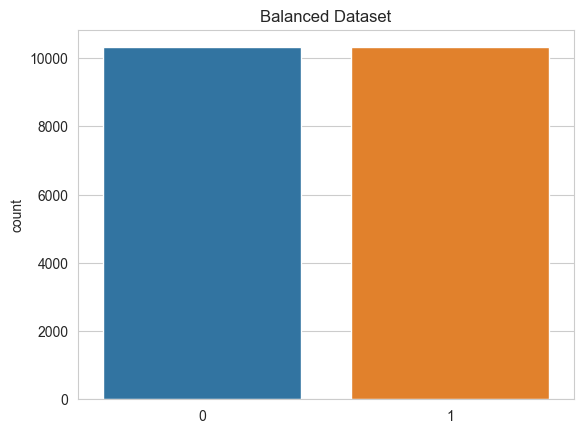

In [217]:
sns.countplot(x=y_train).set_title("Balanced Dataset")
plt.show()

# 6. Modelling

## Build Pipelines

In [220]:
# Import pipeline dependencies
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [221]:
# Import algorithms
from sklearn.linear_model import SGDClassifier, RidgeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier

In [222]:
pipelines = {
    "sgd": make_pipeline(StandardScaler(), SGDClassifier()),
    "ridge": make_pipeline(StandardScaler(), RidgeClassifier()),
    "rf": make_pipeline(StandardScaler(), RandomForestClassifier()),
    "gb": make_pipeline(StandardScaler(), GradientBoostingClassifier()),
    "xg": make_pipeline(StandardScaler(), XGBClassifier()),
}

## Build Grids

In [223]:
pipelines["gb"].get_params()

{'memory': None,
 'steps': [('standardscaler', StandardScaler()),
  ('gradientboostingclassifier', GradientBoostingClassifier())],
 'verbose': False,
 'standardscaler': StandardScaler(),
 'gradientboostingclassifier': GradientBoostingClassifier(),
 'standardscaler__copy': True,
 'standardscaler__with_mean': True,
 'standardscaler__with_std': True,
 'gradientboostingclassifier__ccp_alpha': 0.0,
 'gradientboostingclassifier__criterion': 'friedman_mse',
 'gradientboostingclassifier__init': None,
 'gradientboostingclassifier__learning_rate': 0.1,
 'gradientboostingclassifier__loss': 'log_loss',
 'gradientboostingclassifier__max_depth': 3,
 'gradientboostingclassifier__max_features': None,
 'gradientboostingclassifier__max_leaf_nodes': None,
 'gradientboostingclassifier__min_impurity_decrease': 0.0,
 'gradientboostingclassifier__min_samples_leaf': 1,
 'gradientboostingclassifier__min_samples_split': 2,
 'gradientboostingclassifier__min_weight_fraction_leaf': 0.0,
 'gradientboostingclassifie

In [224]:
??RandomForestClassifier

Init signature:
RandomForestClassifier(
    n_estimators=100,
    *,
    criterion='gini',
    max_depth=None,
    min_samples_split=2,
    min_samples_leaf=1,
    min_weight_fraction_leaf=0.0,
    max_features='sqrt',
    max_leaf_nodes=None,
    min_impurity_decrease=0.0,
    bootstrap=True,
    oob_score=False,
    n_jobs=None,
    random_state=None,
    verbose=0,
    warm_start=False,
    class_weight=None,
    ccp_alpha=0.0,
    max_samples=None,
)
Source:        
class RandomForestClassifier(ForestClassifier):
    """
    A random forest classifier.

    A random forest is a meta estimator that fits a number of decision tree
    classifiers on various sub-samples of the dataset and uses averaging to
    improve the predictive accuracy and control over-fitting.
    The sub-sample size is controlled with the `max_samples` parameter if
    `bootstrap=True` (default), otherwise the whole dataset is used to build
    each tree.

    For a comparison between tree-based ensemble models

In [225]:
grid = {
    "sgd": {"sgdclassifier__alpha": [0.00001, 0.0001, 0.001, 0.01]},
    "ridge": {"ridgeclassifier__alpha": [0.01, 0.5, 1.0, 2.0, 3.0]},
    "rf": {
        "randomforestclassifier__n_estimators": [50, 100, 200, 300],
        "randomforestclassifier__max_depth": [None, 5, 7, 9],
    },
    "gb": {
        "gradientboostingclassifier__n_estimators": [50, 100, 200, 300],
        "gradientboostingclassifier__max_depth": [None, 3, 5, 7, 9],
    },
    "xg": {
        "xgbclassifier__n_estimators": [50, 100, 200, 300],
        "xgbclassifier__max_depth": [None, 3, 5, 7, 9],
    },
}

## Train Models

In [226]:
from sklearn.model_selection import GridSearchCV

In [229]:
fit_models = {}
for algo, pipeline in pipelines.items():
    try:
        print(f"Commencing training for {algo}")
        # DO training here
        model = GridSearchCV(pipeline, grid[algo], n_jobs=-1, cv=10)
        model.fit(X_train, y_train)
        fit_models[algo] = model
        print(f"Training completed for {algo}")
    except Exception as e:
        print(f"There was an error training the {algo} model: {e}")

Commencing training for sgd
Training completed for sgd
Commencing training for ridge
Training completed for ridge
Commencing training for rf
Training completed for rf
Commencing training for gb
Training completed for gb
Commencing training for xg


/Users/valentinmonney/Desktop/Full Stack Machine Learning/fullstack/lib/python3.9/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Training completed for xg


In [230]:
fit_models

{'sgd': GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                        ('sgdclassifier', SGDClassifier())]),
              n_jobs=-1,
              param_grid={'sgdclassifier__alpha': [1e-05, 0.0001, 0.001, 0.01]}),
 'ridge': GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                        ('ridgeclassifier', RidgeClassifier())]),
              n_jobs=-1,
              param_grid={'ridgeclassifier__alpha': [0.01, 0.5, 1.0, 2.0, 3.0]}),
 'rf': GridSearchCV(cv=10,
              estimator=Pipeline(steps=[('standardscaler', StandardScaler()),
                                        ('randomforestclassifier',
                                         RandomForestClassifier())]),
              n_jobs=-1,
              param_grid={'randomforestclassifier__max_depth': [None, 5, 7, 9],
                          'randomforestclassifier__n_estimators':

# 7. Evaluation

## Apply Transformations to Test Data

In [231]:
col_order = X_train.columns
col_order

Index(['tenure', 'contract_length', 'remaining_term', 'last_nps_rating',
       'number_vmail_messages', 'total_day_calls', 'total_eve_calls',
       'total_night_calls', 'total_intl_calls',
       'number_customer_service_calls', 'total_eve_minutes_missing',
       'day_ratio', 'eve_ratio', 'night_ratio', 'intl_ratio',
       'unhappy_customers', 'state_code_AK', 'state_code_AL', 'state_code_AR',
       'state_code_AZ', 'state_code_CA', 'state_code_CO', 'state_code_CT',
       'state_code_DC', 'state_code_DE', 'state_code_FL', 'state_code_GA',
       'state_code_HI', 'state_code_IA', 'state_code_ID', 'state_code_IL',
       'state_code_IN', 'state_code_KS', 'state_code_KY', 'state_code_LA',
       'state_code_MA', 'state_code_MD', 'state_code_ME', 'state_code_MI',
       'state_code_MN', 'state_code_MO', 'state_code_MS', 'state_code_MT',
       'state_code_NC', 'state_code_ND', 'state_code_NE', 'state_code_NH',
       'state_code_NJ', 'state_code_NM', 'state_code_NV', 'state_code_NY',

In [232]:
def transform_data(test_df, col_order, mean_eve_mins, onehot):
    # Copy dataframe
    X = test_df.copy()

    # DP - Handle Missing values
    X["area_code"] = X["area_code"].fillna("missing")
    X["voice_mail_plan"] = X["voice_mail_plan"].fillna("missing")
    X["total_eve_minutes_missing"] = X["total_eve_minutes"].isnull().astype(int)
    X["total_eve_minutes"] = X["total_eve_minutes"].fillna(mean_eve_mins)

    # FE - Ratios
    X["day_ratio"] = X["total_day_charge"] / X["total_day_minutes"]
    X["eve_ratio"] = X["total_eve_charge"] / X["total_eve_minutes"]
    X["night_ratio"] = X["total_night_charge"] / X["total_night_minutes"]
    X["intl_ratio"] = X["total_intl_charge"] / X["total_intl_minutes"]
    X = X.drop(
        [
            "total_day_charge",
            "total_eve_charge",
            "total_night_charge",
            "total_intl_charge",
            "total_day_minutes",
            "total_eve_minutes",
            "total_night_minutes",
            "total_intl_minutes",
        ],
        axis=1,
    )

    # FE - Log Transform
    X["number_customer_service_calls"] = np.log(X["number_customer_service_calls"] + 1)

    # FE - Unhappy Customers
    X["promotions_offered"] = X["promotions_offered"].replace(["NO", np.NaN], "No")
    X["unhappy_customers"] = (
        (X.remaining_term < 5)
        & (X.last_nps_rating <= 7)
        & (X.promotions_offered == "No")
    ).astype(int)

    # Onehot encoder
    encoded_columns = onehot.transform(X.select_dtypes(include="object")).toarray()
    X = X.select_dtypes(exclude="object")
    X[onehot.get_feature_names_out()] = encoded_columns

    return X[col_order]

In [233]:
test = test[~test["churn"].isnull()]

In [234]:
test.isnull().sum()

state_code                        0
tenure                            0
contract_length                   0
promotions_offered                0
remaining_term                    0
last_nps_rating                   0
area_code                         5
international_plan                0
voice_mail_plan                  10
number_vmail_messages             0
total_day_minutes                 0
total_day_calls                   0
total_day_charge                  0
total_eve_minutes                 6
total_eve_calls                   0
total_eve_charge                  0
total_night_minutes               0
total_night_calls                 0
total_night_charge                0
total_intl_minutes                0
total_intl_calls                  0
total_intl_charge                 0
number_customer_service_calls     0
churn                             0
dtype: int64

In [235]:
X_test = transform_data(test.drop("churn", axis=1), col_order, mean_eve_mins, onehot)

In [236]:
X_test

,tenure,contract_length,remaining_term,last_nps_rating,number_vmail_messages,total_day_calls,total_eve_calls,total_night_calls,total_intl_calls,number_customer_service_calls,...,promotions_offered_Yes,area_code_area_code_408,area_code_area_code_415,area_code_area_code_510,area_code_missing,international_plan_no,international_plan_yes,voice_mail_plan_missing,voice_mail_plan_no,voice_mail_plan_yes
id,,,,,,,,,,,,,,,,,,,,,
15297,75,13.0,3.0,9.0,1,121,63,97,6,1.386294,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7075,150,17.0,5.0,9.0,1,111,78,88,4,0.693147,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
3733,87,11.0,6.0,9.0,2,132,95,49,2,0.693147,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
10674,110,9.0,19.0,6.0,1,85,116,90,3,0.693147,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7360,132,23.0,2.0,1.0,0,101,90,93,8,0.693147,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1120,44,24.0,9.0,10.0,2,71,104,113,3,1.386294,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0
7101,113,22.0,17.0,9.0,1,112,76,97,6,0.693147,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
7062,111,22.0,24.0,9.0,16,78,121,105,8,0.693147,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0


In [237]:
y_test = np.where(test["churn"] == "yes", 1, 0)

## Evaluate Performance Metrics

In [280]:
from sklearn.metrics import (
    accuracy_score,
    recall_score,
    precision_score,
    f1_score,
    confusion_matrix,
)

In [281]:
# Create an empty dataframe
scores_df = pd.DataFrame(columns=["Algorithm", "Accuracy", "Precision", "Recall"])

# Loop through the models
for algo, model in fit_models.items():
    # Make predictions
    yhat = model.predict(X_test)
    # Calculating metrics test partition and our predictions
    accuracy = accuracy_score(y_test, yhat)
    precision = precision_score(y_test, yhat)
    recall = recall_score(y_test, yhat)
    f1 = f1_score(y_test, yhat)
    # Append scores to the dataframe
    scores_df = pd.concat(
        [
            scores_df,
            pd.DataFrame(
                {
                    "Algorithm": [algo],
                    "Accuracy": [accuracy],
                    "Precision": [precision],
                    "Recall": [recall],
                    "f1": [f1],
                }
            ),
        ],
        ignore_index=True,
    )

# Print the dataframe
print(scores_df)

  Algorithm  Accuracy  Precision    Recall        f1
0       sgd  0.890204   0.572856  0.928475  0.708548
1     ridge  0.862270   0.511143  0.959514  0.666979
2        rf  0.948788   0.805378  0.848853  0.826544
3        gb  0.953443   0.833555  0.844804  0.839142
4        xg  0.953443   0.843621  0.829960  0.836735


- The precision is the ratio tp / (tp + fp) where tp is the number of true positives and fp the number of false positives. The precision is intuitively the ability of the classifier not to label as positive a sample that is negative.
- The recall is the ratio tp / (tp + fn) where tp is the number of true positives and fn the number of false negatives. The recall is intuitively the ability of the classifier to find all the positive samples.

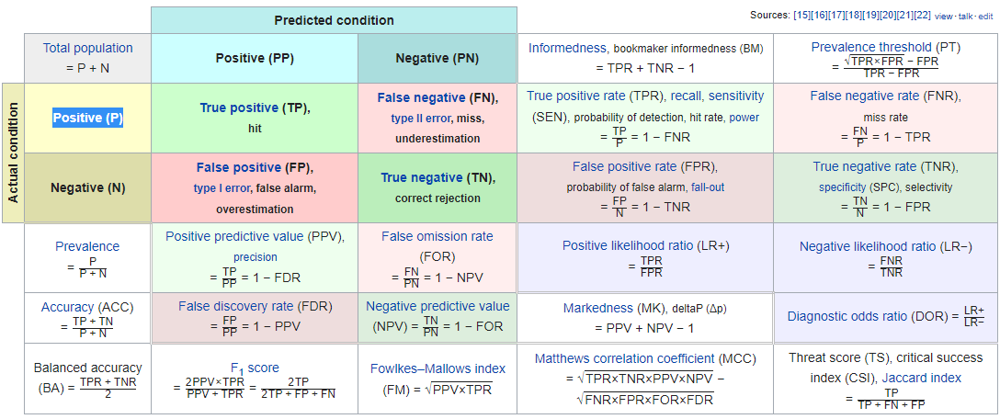

## Understanding Performance Metrics

In [240]:
model = fit_models["rf"]

In [241]:
yhat = model.predict(X_test)

In [242]:
yhat[:50]

array([0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0])

In [243]:
confusion_matrix(y_test, yhat, labels=[1, 0])

array([[ 629,  112],
       [ 152, 4262]])

In [244]:
accuracy = (669 + 4195) / (669 + 4195 + 219 + 72)
accuracy

0.9435499515033947

In [245]:
precision = 669 / (219 + 669)
precision

0.7533783783783784

In [246]:
recall = 669 / (669 + 72)
recall

0.902834008097166

## Make a Prediction

In [247]:
yhat = model.predict(X_test)
yhat

array([0, 0, 0, ..., 0, 0, 0])

In [248]:
# Create dataframe
res = pd.DataFrame([y_test, yhat])
res = res.T
res.columns = ["ytrue", "ypred"]
res.head(6)

,ytrue,ypred
0,0,0
1,0,0
2,0,0
3,0,0
4,1,1
5,1,0


In [249]:
X_test.iloc[5]

tenure                     125.0
contract_length             16.0
remaining_term               7.0
last_nps_rating              2.0
number_vmail_messages       36.0
                           ...  
international_plan_no        1.0
international_plan_yes       0.0
voice_mail_plan_missing      0.0
voice_mail_plan_no           0.0
voice_mail_plan_yes          1.0
Name: 13546, Length: 78, dtype: float64

# 8. Deployment

## Save Models and Encoder

In [250]:
import os
import pickle

In [251]:
# Create file paths
SAVE_PATH = os.path.join("models", "experiment_2")
if not os.path.exists(SAVE_PATH):
    os.makedirs(SAVE_PATH)

In [252]:
# Save machine learning models
for algo, model in fit_models.items():
    FILE_PATH = os.path.join(SAVE_PATH, f"{algo}.pkl")
    with open(FILE_PATH, "wb") as f:
        pickle.dump(model, f)

In [253]:
# Save one hot encoder
ENCODER_FILE_PATH = os.path.join(SAVE_PATH, "encoder.pkl")
with open(ENCODER_FILE_PATH, "wb") as f:
    pickle.dump(onehot, f)

## Create a Model Schema

In [254]:
def extract_column_values(col, df):
    if df[col].dtype == "O":
        return list(df[col].unique())
    elif df[col].dtype == "int64":
        return (int(df[col].min()), int(df[col].max()))
    elif df[col].dtype == "float64":
        return (float(df[col].min()), float(df[col].max()))
    else:
        return list(df[col].unique().astype(str))

In [259]:
df.select_dtypes(include=float)

,contract_length,remaining_term,last_nps_rating,total_day_minutes,total_day_charge,total_eve_minutes,total_eve_charge,total_night_minutes,total_night_charge,total_intl_minutes,total_intl_charge
id,,,,,,,,,,,
0,14.0,1.0,6.0,167.054217,29.307181,231.986495,19.138302,208.349932,9.190181,8.015688,2.248902
1,8.0,14.0,9.0,218.925536,37.440646,190.771110,15.474436,228.902063,10.277852,9.683971,2.609739
2,20.0,12.0,1.0,187.906791,32.435515,268.382272,22.547297,202.353527,8.898488,14.039450,3.845776
3,9.0,12.0,6.0,173.184915,27.000958,195.564328,16.666506,214.487530,9.740333,13.031063,3.525823
4,19.0,22.0,5.0,221.961743,38.720238,237.915602,20.408969,190.047534,8.813303,6.760950,1.828652
...,...,...,...,...,...,...,...,...,...,...,...
17238,14.0,1.0,1.0,262.192341,43.855880,172.019041,14.191124,62.263008,2.872740,0.493638,0.250048
17239,8.0,9.0,7.0,169.541796,28.373738,286.519733,23.784585,224.625284,10.627770,12.870274,3.370551
17240,24.0,3.0,7.0,173.580360,27.250409,252.831025,21.482982,146.474026,6.367553,14.037650,4.001911


In [263]:
column_info = {
    col: {"dtype": str(df[col].dtype), "values": extract_column_values(col, df)}
    for col in df.columns
}

In [264]:
column_info

{'state_code': {'dtype': 'object',
  'values': ['HI',
   'MI',
   'NH',
   'MN',
   'TX',
   'WY',
   'IN',
   'IL',
   'TN',
   'MA',
   'DC',
   'NV',
   'PA',
   'AK',
   'NM',
   'WI',
   'ND',
   'NJ',
   'AR',
   'NE',
   'NY',
   'OK',
   'SD',
   'KY',
   'ID',
   'VT',
   'IA',
   'MT',
   'AL',
   'MS',
   'ME',
   'WV',
   'RI',
   'VA',
   'OH',
   'SC',
   'MD',
   'CO',
   'AZ',
   'NC',
   'CT',
   'MO',
   'UT',
   'DE',
   'WA',
   'KS',
   'CA',
   'FL',
   'LA',
   'GA',
   'OR']},
 'tenure': {'dtype': 'int64', 'values': (1, 242)},
 'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
 'promotions_offered': {'dtype': 'object', 'values': ['Yes', 'No', 'NO', nan]},
 'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
 'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
 'area_code': {'dtype': 'object',
  'values': ['area_code_510', 'area_code_408', 'area_code_415', nan]},
 'international_plan': {'dtype': 'object', 'values': ['no', 'yes

In [265]:
transformed_cols = {"transformed_columns": X_train.columns.to_list()}
schema = {"column_info": column_info, "transformed_columns": transformed_cols}

In [266]:
schema

{'column_info': {'state_code': {'dtype': 'object',
   'values': ['HI',
    'MI',
    'NH',
    'MN',
    'TX',
    'WY',
    'IN',
    'IL',
    'TN',
    'MA',
    'DC',
    'NV',
    'PA',
    'AK',
    'NM',
    'WI',
    'ND',
    'NJ',
    'AR',
    'NE',
    'NY',
    'OK',
    'SD',
    'KY',
    'ID',
    'VT',
    'IA',
    'MT',
    'AL',
    'MS',
    'ME',
    'WV',
    'RI',
    'VA',
    'OH',
    'SC',
    'MD',
    'CO',
    'AZ',
    'NC',
    'CT',
    'MO',
    'UT',
    'DE',
    'WA',
    'KS',
    'CA',
    'FL',
    'LA',
    'GA',
    'OR']},
  'tenure': {'dtype': 'int64', 'values': (1, 242)},
  'contract_length': {'dtype': 'float64', 'values': (8.0, 24.0)},
  'promotions_offered': {'dtype': 'object',
   'values': ['Yes', 'No', 'NO', nan]},
  'remaining_term': {'dtype': 'float64', 'values': (1.0, 24.0)},
  'last_nps_rating': {'dtype': 'float64', 'values': (1.0, 10.0)},
  'area_code': {'dtype': 'object',
   'values': ['area_code_510', 'area_code_408', 'area_code_

In [270]:
if not os.path.exists("app"):
    os.makedirs("app")

In [268]:
import json

with open(os.path.join("app", "schema.json"), "w") as f:
    json.dump(schema, f)

# 9. Test Scoring

## Load Models and Encoder

In [282]:
# Load ML Model
with open(os.path.join(SAVE_PATH, "gb.pkl"), "rb") as f:
    model = pickle.load(f)

In [283]:
# Load Encoder
with open(os.path.join(SAVE_PATH, "encoder.pkl"), "rb") as f:
    onehot = pickle.load(f)

In [284]:
# Load Schema
with open(os.path.join("app", "schema.json"), "r") as f:
    schema = json.load(f)

## Transform Test Sample and Predict

You can format that on vs code by right clicking and format.

In [286]:
df.iloc[0].to_json()

'{"state_code":"HI","tenure":156,"contract_length":14.0,"promotions_offered":"Yes","remaining_term":1.0,"last_nps_rating":6.0,"area_code":"area_code_510","international_plan":"no","voice_mail_plan":"no","number_vmail_messages":0,"total_day_minutes":167.0542167,"total_day_calls":63,"total_day_charge":29.30718149,"total_eve_minutes":231.9864949,"total_eve_calls":108,"total_eve_charge":19.13830209,"total_night_minutes":208.3499316,"total_night_calls":130,"total_night_charge":9.190181033,"total_intl_minutes":8.01568848,"total_intl_calls":7,"total_intl_charge":2.24890244,"number_customer_service_calls":7,"churn":"no"}'

In [285]:
res = {
    "state_code": "OH",
    "area_code": "area_code_415",
    "international_plan": "no",
    "voice_mail_plan": "yes",
    "number_vmail_messages": "26",
    "total_day_minutes": 161.6,
    "total_day_calls": 123,
    "total_day_charge": 27.47,
    "total_eve_minutes": 195.5,
    "total_eve_calls": 103,
    "total_eve_charge": 16.62,
    "total_night_minutes": 254.4,
    "total_night_calls": 103,
    "total_night_charge": 11.45,
    "total_intl_minutes": 13.7,
    "total_intl_calls": 3,
    "total_intl_charge": 3.7,
    "promotions_offered": "No",
    "number_customer_service_calls": 5.0,
    "tenure": 4,
    "contract_length": 5,
    "remaining_term": 10,
    "last_nps_rating": 10,
}

In [291]:
# Extract column orders
column_order_in = list(schema["column_info"].keys())[:-1]
column_order_out = list(schema["transformed_columns"]["transformed_columns"])

In [297]:
# Convert single prediction to a DF
scoring_data = pd.Series(res).to_frame().T
scoring_data = scoring_data[column_order_in]

In [298]:
scoring_data

,state_code,tenure,contract_length,promotions_offered,remaining_term,last_nps_rating,area_code,international_plan,voice_mail_plan,number_vmail_messages,...,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
0,OH,4,5,No,10,10,area_code_415,no,yes,26,...,195.5,103,16.62,254.4,103,11.45,13.7,3,3.7,5.0


In [299]:
# Check datatypes and apply preprocessing
for column, column_properties in schema["column_info"].items():
    if column != "churn":
        dtype = column_properties["dtype"]
        scoring_data[column] = scoring_data[column].astype(dtype)

In [303]:
scoring_sample = transform_data(scoring_data, column_order_out, mean_eve_mins, onehot)

In [305]:
model.predict(scoring_sample)

array([0])